In [1]:
import os
from IPython.display import display
import pandas as pd
from scipy import stats
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
from sklearn.cluster import KMeans
from preprocessing import load_data
from ydata_profiling import ProfileReport
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.feature_selection import RFE, VarianceThreshold
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_score, mean_squared_error, mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from imblearn.over_sampling import SMOTE
%matplotlib inline

In [20]:
# df = load_data(file_path='../data/dataset.csv')
PATH = os.getcwd()
df = pd.read_csv(
    os.path.join(PATH, "data/enriched_synthetic_data.csv")
)
# df.drop(["music_id"], axis=1, inplace=True)
df.head()

,user_id,age,education,gender,country,music,artist_name,featured_artists,genre,duration,...,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,time_signature,release_date,explicit
0,83811,16,Undergraduate,F,Urban,Bank Account,21 Savage,"Birdy, Zoé",Dark Trap,3.67,...,-8.228000,0,0.351000,0.000007,0.087100,0.376000,75.016000,4.0,2017-09-23,True
1,83811,16,Undergraduate,F,Urban,Little Talks,Of Monsters and Men,"Ninho, Snoop Dogg, Russ, Paramore",NaN,4.44,...,-7.879000,1,0.032200,0.000000,0.284500,0.413000,101.890500,4.0,2013-04-12,False
2,13397,17,Middle School,M,Non-Urban,Wherever I Go,OneRepublic,"Keith Urban, DJ Khaled, NIKI, MF DOOM",NaN,2.83,...,-7.344833,1,0.089400,0.043432,0.273133,0.404183,120.850500,4.0,2009-02-03,False
3,70645,44,Graduate,M,Non-Urban,No New Friends,DJ Khaled,"The xx, LIT killah",Pop,5.14,...,-7.606000,1,0.167000,0.000000,0.096600,0.400000,109.283000,4.0,2017-01-01,False
4,70645,44,Graduate,M,Non-Urban,Dreams,Campsite Dream,NaN,Country,3.20,...,-9.894632,1,0.078837,0.235527,0.180354,0.380815,120.488479,4.0,1974,False


In [21]:
# drop unused columns
df.drop(["education","country"], axis=1, inplace=True)

In [22]:
print(df.shape)  # prints the dimensions of the DataFrame

(19974, 24)


In [23]:
# Define presets for data visualization
def presets():
    plt.rc('figure', autolayout = True)

    plt.rc('axes', 
        labelsize = 'large',
        labelweight = 'bold',
        titlesize = 14,
        titleweight = 'bold',
        titlepad = 10       
    )

    %config InlineBackend.figure_format = 'retina'
    pd.options.display.max_rows = 10
    sns.set_style('darkgrid')
    # Set preset for darkmode for matplotlib and seaborn visualizations
    plt.style.use('dark_background')

    warnings.filterwarnings(action = 'ignore', category = UserWarning)
    return 

presets()



In [24]:
df.info(memory_usage="deep")  # prints the memory usage of the DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19974 entries, 0 to 19973
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   user_id           19974 non-null  int64  
 1   age               19974 non-null  int64  
 2   gender            19974 non-null  object 
 3   music             19974 non-null  object 
 4   artist_name       19974 non-null  object 
 5   featured_artists  9618 non-null   object 
 6   genre             17450 non-null  object 
 7   duration          19974 non-null  float64
 8   music_id          19974 non-null  object 
 9   id_artists        19974 non-null  object 
 10  acousticness      19974 non-null  float64
 11  danceability      19974 non-null  float64
 12  energy            19974 non-null  float64
 13  key               19974 non-null  int64  
 14  loudness          19974 non-null  float64
 15  mode              19974 non-null  int64  
 16  speechiness       19974 non-null  float6

In [25]:
df['release_date'] .value_counts()

release_date
1996          183
2000          181
1972          172
1997          166
1995          165
             ... 
1998-05-01      1
2007-11-08      1
2012-05-19      1
2011-12-27      1
2017-03-22      1
Name: count, Length: 3402, dtype: int64

In [26]:
# df.shape
df.describe(include="all")  # prints the summary statistics of the DataFrame

,user_id,age,gender,music,artist_name,featured_artists,genre,duration,music_id,id_artists,...,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,time_signature,release_date,explicit
count,19974.000000,19974.000000,19974,19974,19974,9618,17450,19974.00000,19974,19974,...,19974.000000,19974.000000,19974.000000,19974.000000,19974.000000,19974.000000,19974.000000,19974.000000,19974,19974
unique,NaN,NaN,2,9470,5085,8585,38,NaN,11528,5087,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3402,2
top,NaN,NaN,M,Closer,Drake,Miracle Tones,Classical,NaN,7BKLCZ1jbUBVqRi2FVlTVw,spotify:artist:3TVXtAsR1Inumwj472S9r4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1996,False
freq,NaN,NaN,10000,49,271,7,1479,NaN,33,271,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,183,18710
mean,49680.999149,35.925253,NaN,NaN,NaN,NaN,NaN,3.87686,NaN,NaN,...,-8.805136,0.729749,0.085706,0.156571,0.186839,0.477929,121.014846,3.944878,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
min,4.000000,13.000000,NaN,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,...,-37.796000,0.000000,0.000000,0.000000,0.009360,0.000000,0.000000,0.000000,NaN,NaN
25%,24543.250000,18.000000,NaN,NaN,NaN,NaN,NaN,3.33000,NaN,NaN,...,-10.082778,0.000000,0.043182,0.000445,0.126085,0.367500,111.692446,4.000000,NaN,NaN
50%,49514.000000,30.000000,NaN,NaN,NaN,NaN,NaN,3.75000,NaN,NaN,...,-8.465000,1.000000,0.063075,0.100860,0.170092,0.464207,120.628039,4.000000,NaN,NaN
75%,74545.750000,52.000000,NaN,NaN,NaN,NaN,NaN,4.28000,NaN,NaN,...,-7.064333,1.000000,0.096595,0.229892,0.215405,0.579846,129.374425,4.000000,NaN,NaN


In [27]:
profile = ProfileReport(
    df, title="EDA Report", explorative=True
)  # generates a profile report of the DataFrame

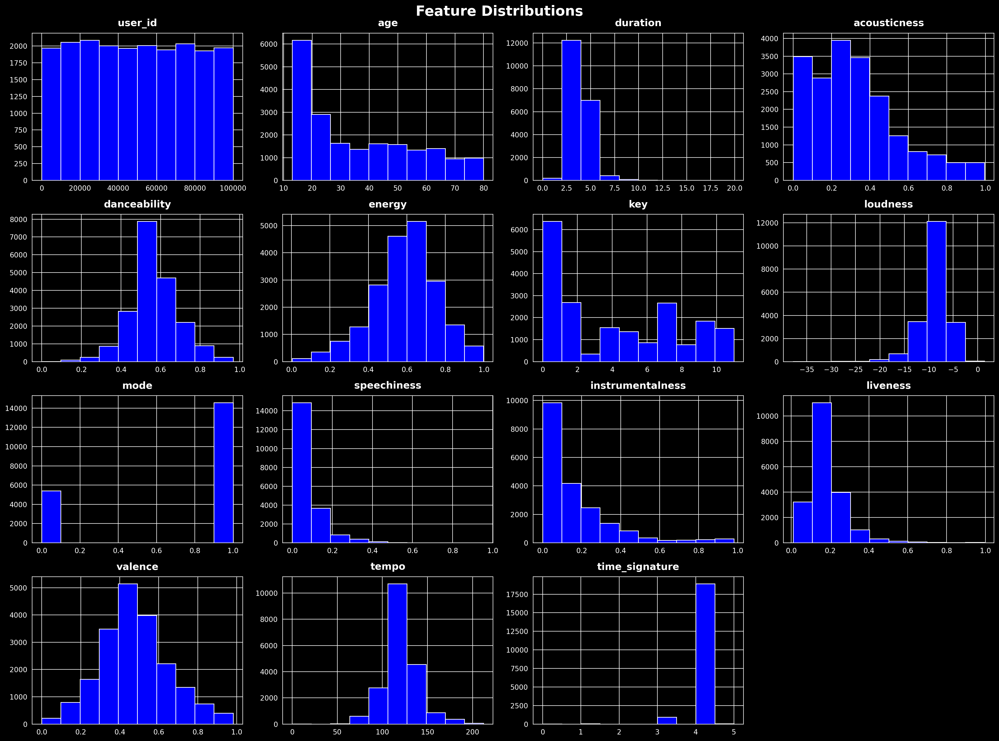

In [28]:
# Plot histograms with sky blue color
supt_presets = dict(fontsize=20, fontweight="bold")

df.hist(figsize=(20, 15), color="blue")
plt.suptitle("Feature Distributions", **supt_presets)
plt.show()  # plots the histograms of the DataFrame with sky blue color

In [29]:
def check_missing_value():
    # show number of missing values as a dataframe by column
    missing_values = df.isnull().sum()
    missing_values = missing_values[missing_values > 0]
    missing_values = missing_values.sort_values(ascending=False)
    missing_values = missing_values.reset_index()
    missing_values.columns = ["Feature", "Missing Values"]
    return missing_values


check_missing_value()

,Feature,Missing Values
0,featured_artists,10356
1,genre,2524


In [31]:
# Fill featured_artists missing values with "Unknown"
df["featured_artists"].fillna("None", inplace=True)

In [32]:
# Fill genre missing values with "Unknown"
df['genre']= df["genre"].fillna("Unknown")

In [33]:
check_missing_value()

,Feature,Missing Values


In [34]:
df.select_dtypes(
    include=["category", "object"]
).columns.tolist()  # prints the columns with categorical data

['gender',
 'music',
 'artist_name',
 'featured_artists',
 'genre',
 'music_id',
 'id_artists',
 'release_date']

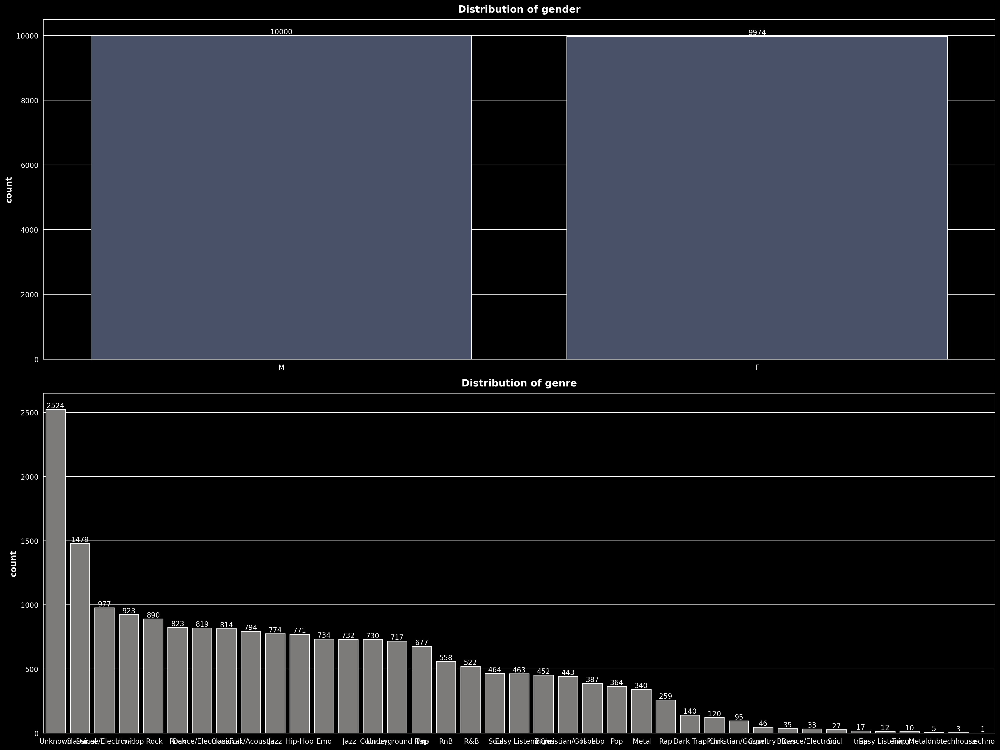

In [35]:
# distribution of categorical columns
cat_cols = ["gender","genre","explicit"]
fig, axes = plt.subplots(2, 1, figsize=(20, 15))
cc = sns.color_palette(n_colors=len(cat_cols), palette="cividis")

for i, ax in enumerate(axes.flatten()):
    # Count the occurrences of each category
    count_data = df[cat_cols[i]].value_counts().sort_values(ascending=False)
    sns.countplot(x=cat_cols[i], data=df, order=count_data.index, ax=ax, color=cc[i])
    ax.set(xlabel="", title=f"Distribution of {cat_cols[i]}")
    ax.bar_label(ax.containers[0], fmt="%.0f")
plt.show()

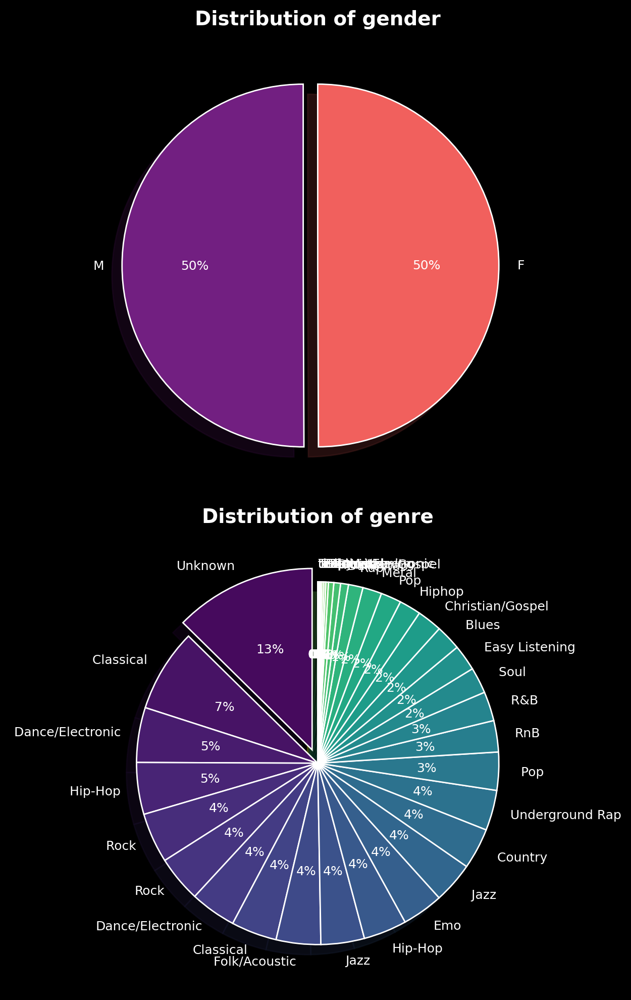

In [36]:
cat_cols = [ "gender", "genre", "explicit"]
fig, axes = plt.subplots(2, 1, figsize=(10, 10))
cc = ["magma", "viridis", "cividis", "magma"]

for i, ax in enumerate(axes.flatten()):
    # Count the occurrences of each category
    count_data = df[cat_cols[i]].value_counts().sort_values(ascending=False)
    # Create pie chart
    n = count_data.shape[0]
    wedges, texts, autotexts = ax.pie(
        count_data,
        labels=count_data.index,
        autopct="%.0f%%",
        colors=sns.color_palette(n_colors=n, palette=cc[i]),
        startangle=90,
        textprops={"fontsize": 9},
        explode=[0.08] + [0] * (n - 1),
        shadow=True,
    )
    ax.set(title=f"Distribution of {cat_cols[i]}")

plt.tight_layout()
plt.show()  # plots the distribution of categorical columns

## Fixing Data Quality Issues With Genre

In [37]:
df['genre'].unique()

array(['Dark Trap', 'Unknown', ' Pop', ' Country', 'Classical', 'Rock',
       'Hiphop', ' Soul  ', 'Dance/Electronic', 'Jazz', ' Soul',
       ' Classical', ' Christian/Gospel', ' Dance/Electronic', 'Hip-Hop',
       ' Hip-Hop', 'Underground Rap', ' Jazz', ' Rock', ' Folk/Acoustic',
       ' Country  ', ' Easy Listening', 'Emo', ' Metal', ' R&B', 'Rap',
       ' Christian/Gospel  ', 'RnB', ' Blues', 'Pop', ' Punk',
       ' Dance/Electronic  ', 'Trap Metal', 'trap', ' Easy Listening  ',
       ' Blues  ', 'dnb', 'techhouse', 'techno'], dtype=object)

In [38]:
# Strip leading and trailing whitespace from the genre column
df['genre'] = df['genre'].str.strip()

# Define the mapping for similar genres
genre_mapping = {
    ' Pop': 'Pop',
    ' Country': 'Country',
    ' Classical': 'Classical',
    ' Christian/Gospel': 'Christian/Gospel',
    ' Dance/Electronic': 'Dance/Electronic',
    ' Hip-Hop': 'Hip-Hop',
    'Hiphop': 'Hip-Hop',
    ' Jazz': 'Jazz',
    ' Rock': 'Rock',
    ' Soul': 'Soul',
    ' Country  ': 'Country',
    ' Christian/Gospel  ': 'Christian/Gospel',
    'R&B': 'RnB',
    'RnB': 'RnB',
}

# Apply the mapping to the genre column
df['genre'] = df['genre'].replace(genre_mapping)

# Verify the cleaned genres
unique_genres = df['genre'].unique()
print(unique_genres)


['Dark Trap' 'Unknown' 'Pop' 'Country' 'Classical' 'Rock' 'Hip-Hop' 'Soul'
 'Dance/Electronic' 'Jazz' 'Christian/Gospel' 'Underground Rap'
 'Folk/Acoustic' 'Easy Listening' 'Emo' 'Metal' 'RnB' 'Rap' 'Blues' 'Punk'
 'Trap Metal' 'trap' 'dnb' 'techhouse' 'techno']


In [39]:
# If genre value counts less than 100, replace with "Other"
genre_counts = df['genre'].value_counts()
other_genres = genre_counts[genre_counts < 100].index
df['genre'] = df['genre'].replace(other_genres, 'Other')

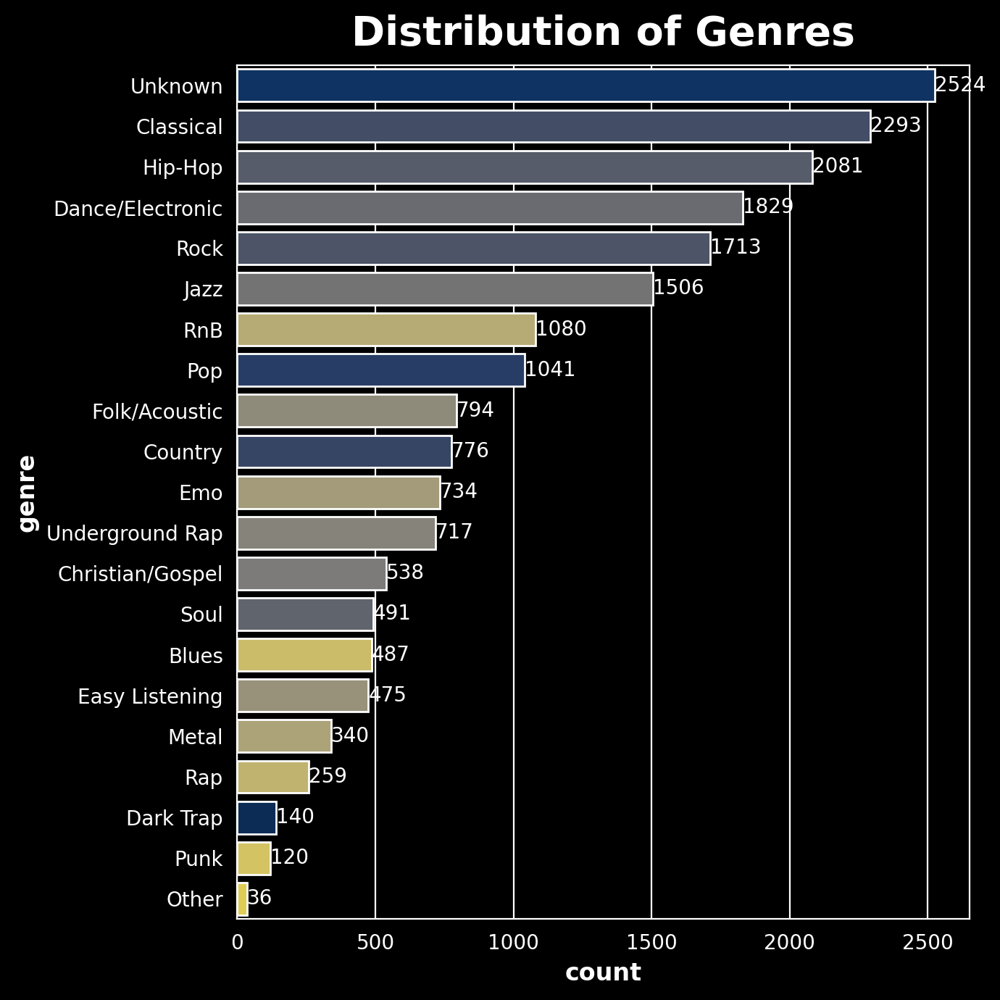

In [40]:
count_order = df["genre"].value_counts().sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(7, 7))
sns.countplot(
    df,
    y="genre",
    hue="genre",
    order=count_order.index,
    ax=ax,
    palette="cividis",
    legend=False,
)
ax.set_title("Distribution of Genres", **supt_presets)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")  # plots the distribution of genres

In [41]:
profile.to_notebook_iframe()  # displays the profile report in the Jupyter notebook

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analysis of Song Names

---


In [42]:
from wordcloud import WordCloud
from collections import Counter
import nltk
from nltk.corpus import stopwords
import string

df_ = df.copy()
# Text Preprocessing
# nltk.download("stopwords")
stop_words = set(stopwords.words("english"))

In [43]:
def preprocess_text(text):
    # Remove punctuation
    text = text.translate(str.maketrans("", "", string.punctuation))
    # Convert to lowercase
    text = text.lower()
    # Remove stopwords
    text = " ".join(word for word in text.split() if word not in stop_words)
    return text


df_["cleaned_music"] = df_["music"].apply(preprocess_text)

# Word Frequency Analysis
all_words = " ".join(df_["cleaned_music"]).split()
word_freq = Counter(all_words)

In [44]:
display(df_["cleaned_music"].head(20))

0      bank account
1      little talks
2       wherever go
3       new friends
4            dreams
          ...      
15           upside
16             love
17         practice
18    crooked teeth
19     livin prayer
Name: cleaned_music, Length: 20, dtype: object

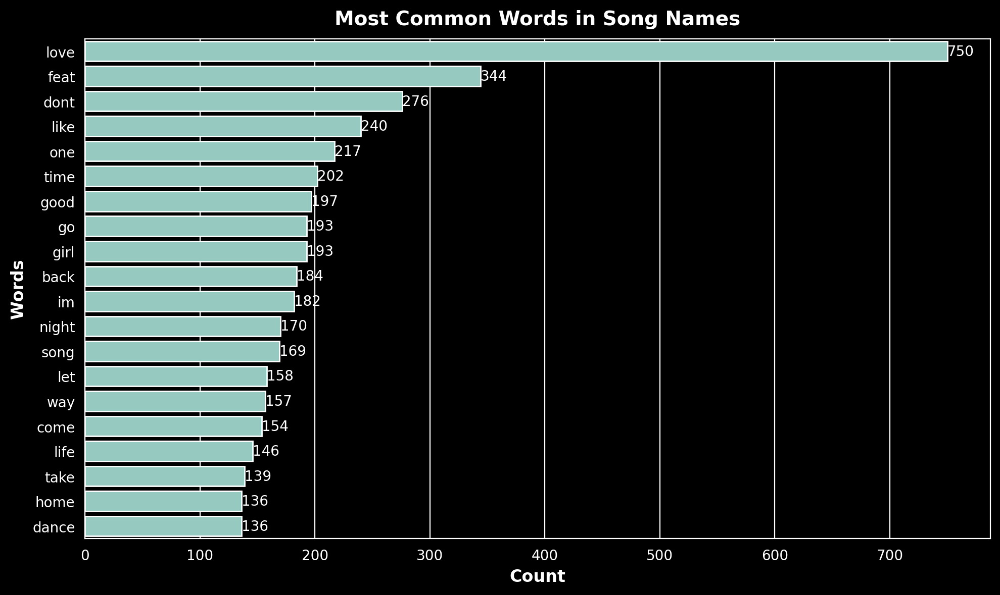

In [45]:
most_common_words = word_freq.most_common(20)

# Plotting Most Common Words
words, counts = zip(*most_common_words)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=list(counts), y=list(words), ax=ax)
plt.title("Most Common Words in Song Names")
plt.xlabel("Count")
plt.ylabel("Words")
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
plt.show()

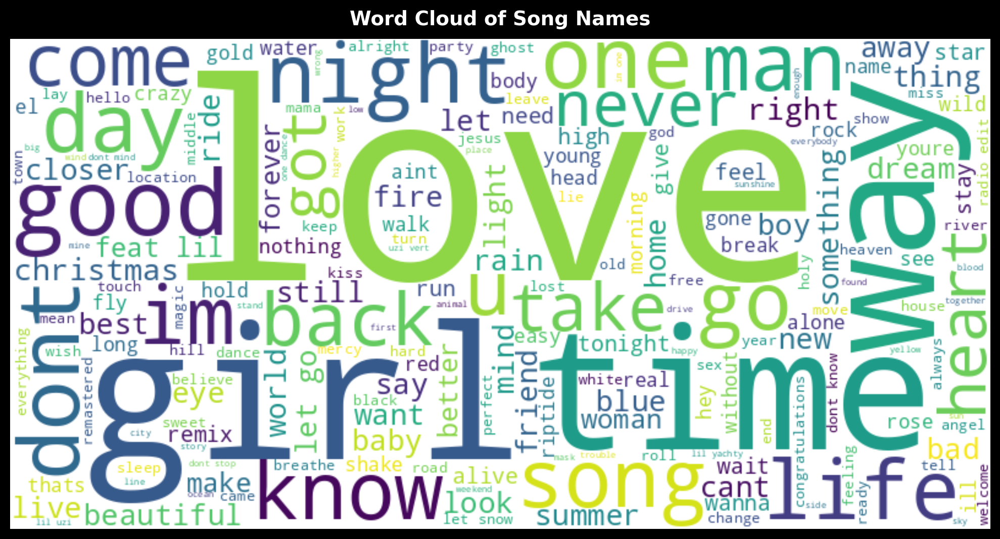

In [46]:
# Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(
    " ".join(all_words)
)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title("Word Cloud of Song Names")
plt.show()

## N-Gram Analysis

---


In [47]:
from nltk.util import ngrams


def get_ngrams(text, n):
    n_grams = ngrams(text.split(), n)
    return [" ".join(grams) for grams in n_grams]


df_["bigrams"] = df_["cleaned_music"].apply(lambda x: get_ngrams(x, 2))
bigram_list = [item for sublist in df_["bigrams"].tolist() for item in sublist]
bigram_freq = Counter(bigram_list)
most_common_bigrams = bigram_freq.most_common(20)

display(most_common_bigrams)

[('let go', 48),
 ('feat lil', 47),
 ('let snow', 29),
 ('dont know', 27),
 ('radio edit', 26),
 ('dont stop', 24),
 ('im one', 23),
 ('dont mind', 23),
 ('one dance', 23),
 ('lil yachty', 23),
 ('lil uzi', 22),
 ('uzi vert', 22),
 ('im gonna', 21),
 ('ispy feat', 21),
 ('say name', 21),
 ('trap queen', 20),
 ('bad boujee', 20),
 ('boujee feat', 20),
 ('let love', 20),
 ('young dumb', 20)]

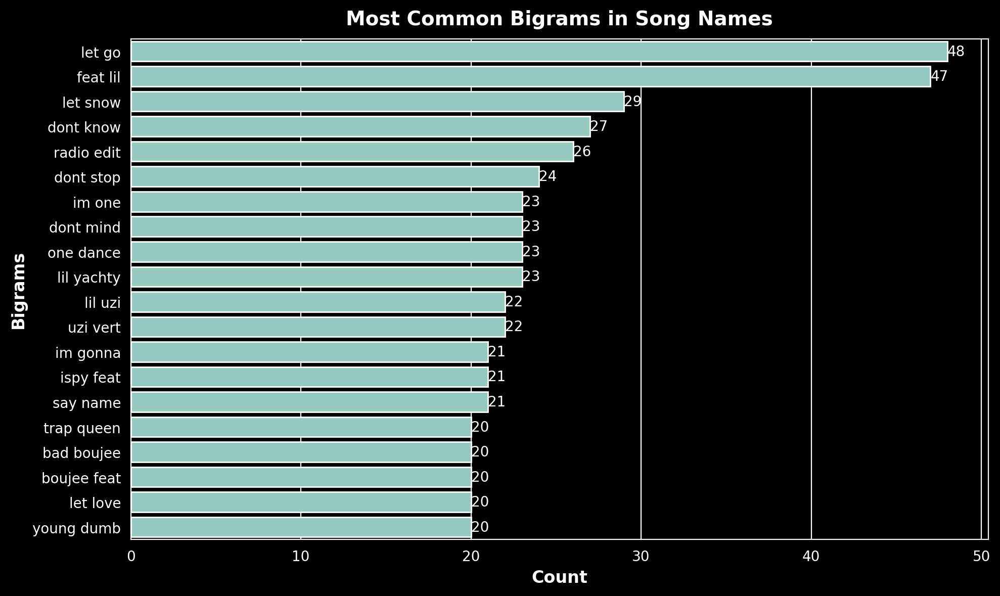

In [48]:
bigrams, counts = zip(*most_common_bigrams)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=list(counts), y=list(bigrams), ax=ax)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
plt.title("Most Common Bigrams in Song Names")
plt.xlabel("Count")
plt.ylabel("Bigrams")
plt.show()

In [49]:
# Select numeric columns only
df_numeric = df.select_dtypes(include=[np.number])

# Identify outliers using IQR method
Q1 = df_numeric.quantile(0.25)
Q3 = df_numeric.quantile(0.75)
IQR = Q3 - Q1

# Define outlier criteria
outliers = (df_numeric < (Q1 - 1.5 * IQR)) | (df_numeric > (Q3 + 1.5 * IQR))
print(outliers.sum())

# Remove outliers
df_no_outliers = df_numeric[
    ~((df_numeric < (Q1 - 1.5 * IQR)) | (df_numeric > (Q3 + 1.5 * IQR))).any(axis=1)
]

user_id                0
age                    0
duration             915
acousticness         691
danceability         852
                    ... 
instrumentalness     918
liveness            1049
valence              405
tempo               1600
time_signature      1076
Length: 15, dtype: int64


## Statistical Tests

In [50]:
df.columns

Index(['user_id', 'age', 'gender', 'music', 'artist_name', 'featured_artists',
       'genre', 'duration', 'music_id', 'id_artists', 'acousticness',
       'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature',
       'release_date', 'explicit'],
      dtype='object')

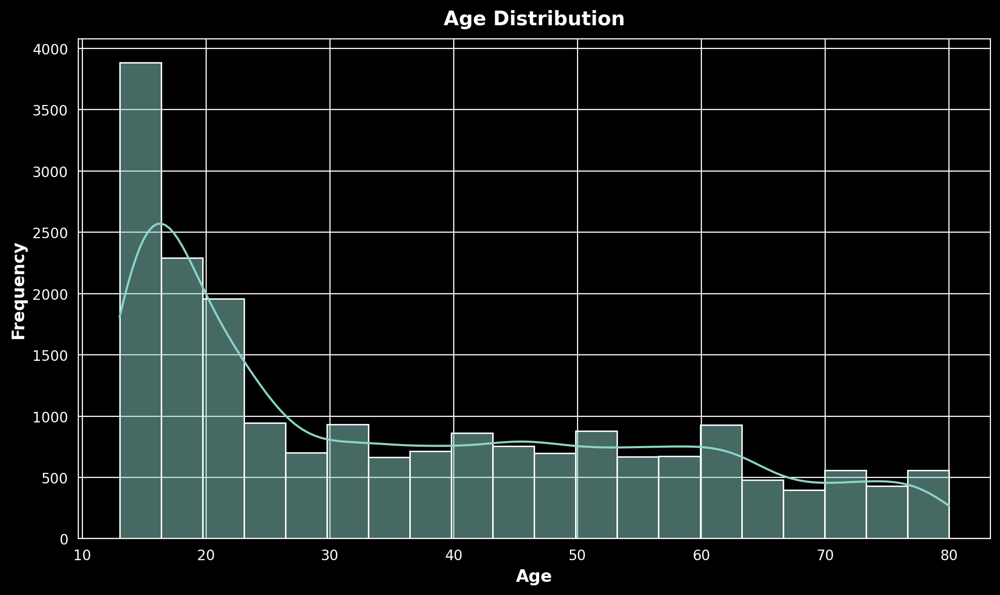

In [51]:
# Histograms for age distribution
plt.figure(figsize=(10, 6))
sns.histplot(df['age'], bins=20, kde=True)
plt.title('Age Distribution')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

In [52]:
df['age_group'] = pd.cut(df['age'], bins=[0,26,42,58,77,100], labels=['Gen Z', 'Millenials', 'Gen X', 'Baby Boomers', 'Silent Generation'])


In [53]:
from scipy.stats import chi2_contingency, f_oneway, ttest_ind

# Chi-Square Test for Independence between gender and genre
contingency_table = pd.crosstab(df['gender'], df['genre'])
chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f'Chi-Square Test:\np-value = {p:.3f}\n{"="*60}\n')

# ANOVA to test differences in danceability across age groups
age_groups = df['age'].unique()
danceability_data = [df[df['age'] == age_group]['danceability'] for age_group in age_groups]
f_stat, p_val = f_oneway(*danceability_data)
print(f'ANOVA:\np-value = {p_val:.3f}')


Chi-Square Test:
p-value = 0.291

ANOVA:
p-value = 0.940


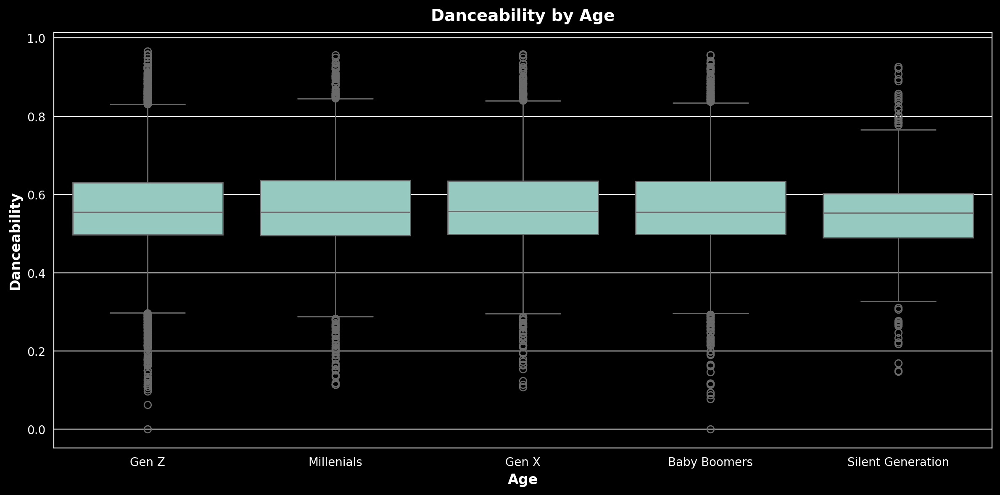

In [54]:
# Visualize danceability across different age groups
plt.figure(figsize=(12, 6))
sns.boxplot(x='age_group', y='danceability', data=df)
plt.title('Danceability by Age')
plt.xlabel('Age')
plt.ylabel('Danceability')
plt.show()

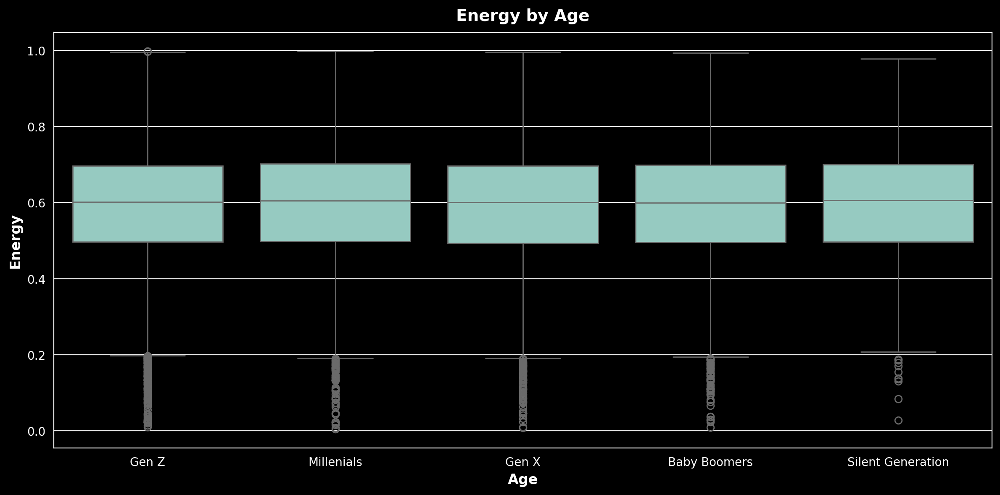

In [55]:
# Visualize energy across different age groups
plt.figure(figsize=(12, 6))
sns.boxplot(x='age_group', y='energy', data=df)
plt.title('Energy by Age')
plt.xlabel('Age')
plt.ylabel('Energy')
plt.show()

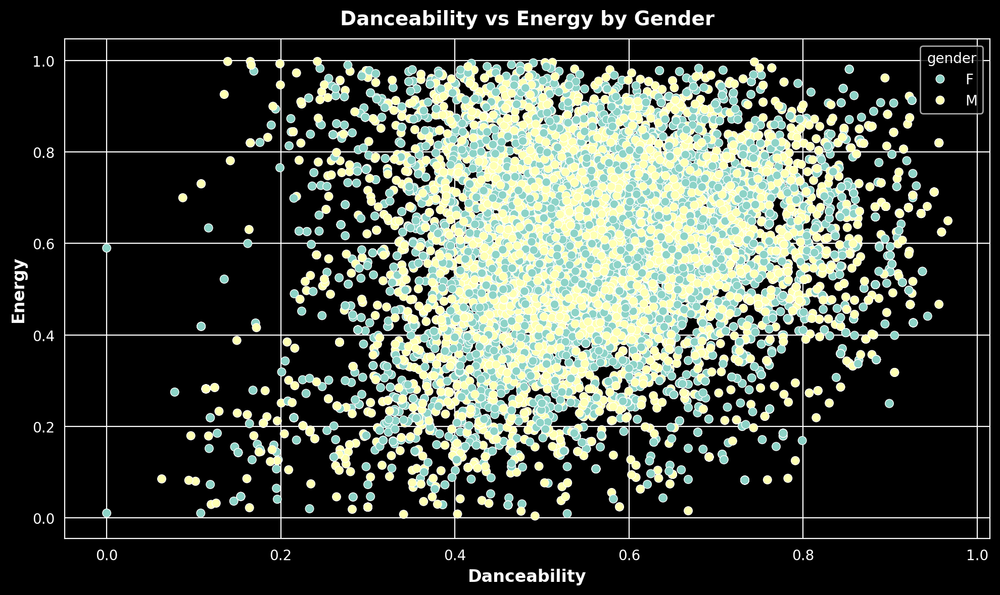

In [56]:
# Scatter plot to explore relationships between danceability and energy
plt.figure(figsize=(10, 6))
sns.scatterplot(x='danceability', y='energy', hue='gender', data=df)
plt.title('Danceability vs Energy by Gender')
plt.xlabel('Danceability')
plt.ylabel('Energy')
plt.show()

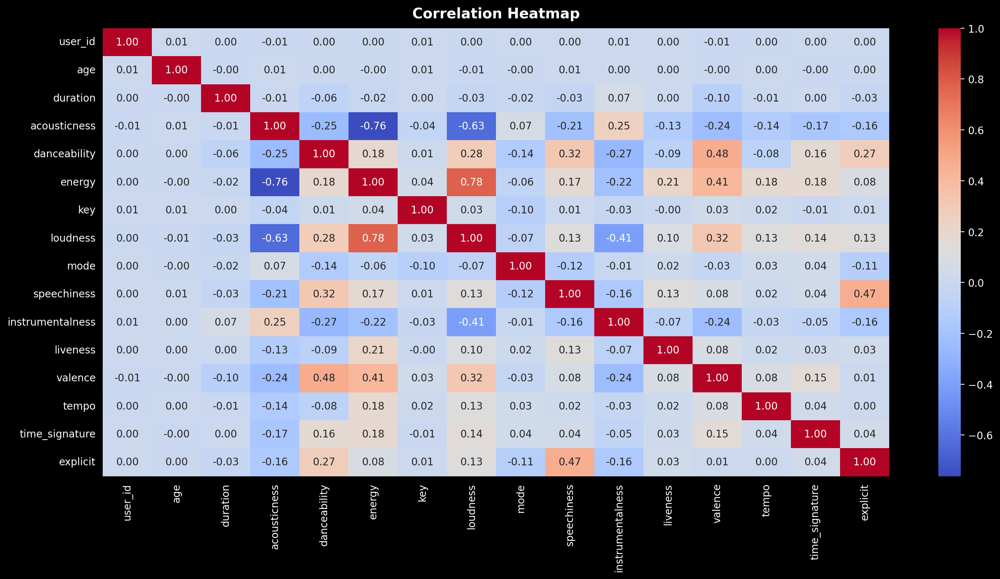

In [57]:
# Plot a correlation heatmap
plt.figure(figsize=(15, 8))
correlation_matrix = df.corr(numeric_only=True)
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()  # plots the correlation heatmap

## Age based Preferences

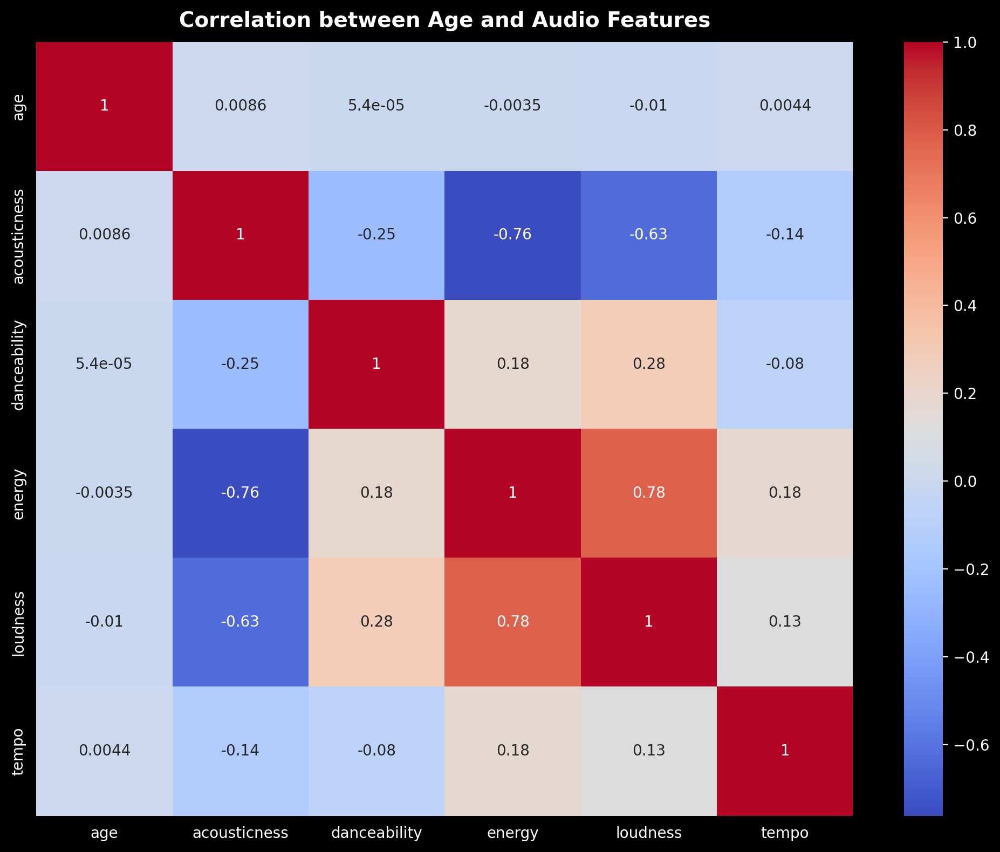

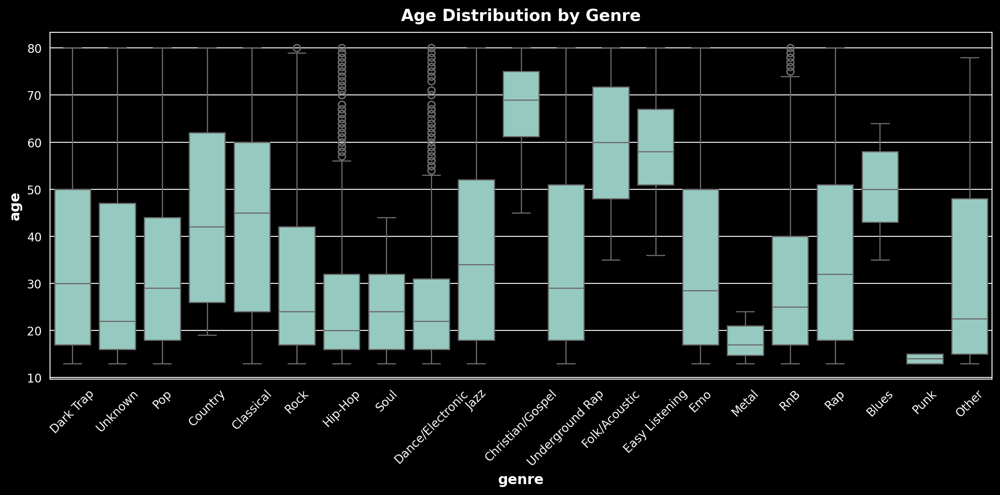

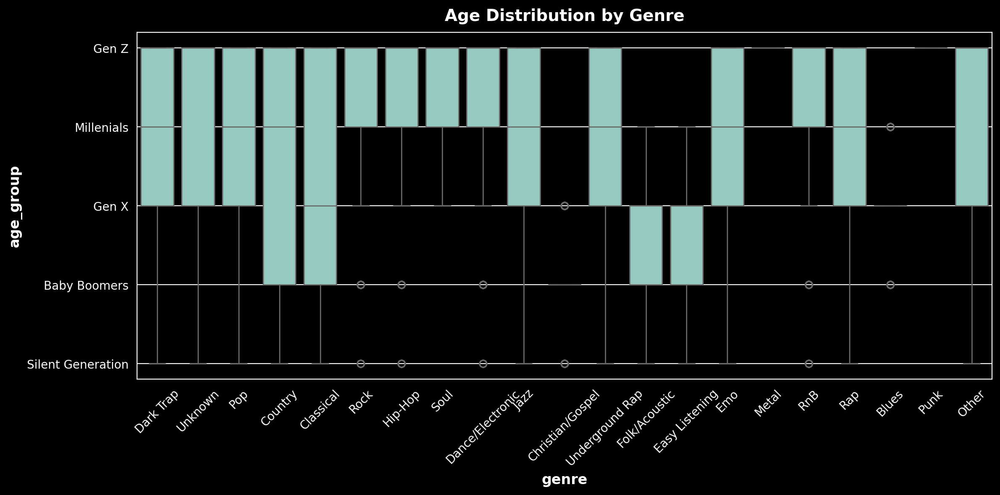

In [58]:
# Correlation between age and audio features
audio_features = ['acousticness', 'danceability', 'energy', 'loudness', 'tempo']
correlation_matrix = df[['age'] + audio_features].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation between Age and Audio Features')
plt.show()

# Age vs Genre preferences
plt.figure(figsize=(12, 6))
sns.boxplot(x='genre', y='age', data=df)
plt.title('Age Distribution by Genre')
plt.xticks(rotation=45)
plt.show()

# Age group vs Genre preferences
plt.figure(figsize=(12, 6))
sns.boxplot(x='genre', y='age_group', data=df)
plt.title('Age Distribution by Genre')
plt.xticks(rotation=45)
plt.show()

## Gender-based preferences

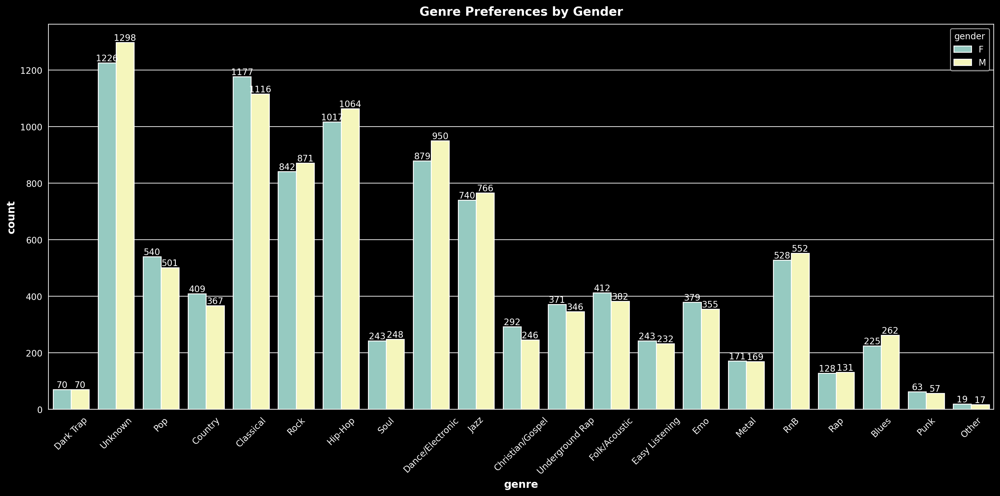

acousticness:
t-statistic = 0.960
p-value = 0.337
danceability:
t-statistic = -1.419
p-value = 0.156
energy:
t-statistic = -0.353
p-value = 0.724
loudness:
t-statistic = -0.467
p-value = 0.640
tempo:
t-statistic = -0.357
p-value = 0.721


In [59]:
# Gender vs Genre preferences
fig, ax = plt.subplots(figsize=(16, 8))
sns.countplot(x='genre', hue='gender', data=df, ax=ax)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
plt.title('Genre Preferences by Gender')
plt.xticks(rotation=45)
plt.show()

# Gender vs Audio Features
for feature in audio_features:
    t_stat, p_value = stats.ttest_ind(df[df['gender'] == 'M'][feature], 
                                      df[df['gender'] == 'F'][feature])
    print(f"{feature}:\nt-statistic = {t_stat:.3f}\np-value = {p_value:.3f}\n{'='* 60}")

## Age and Explicit Content

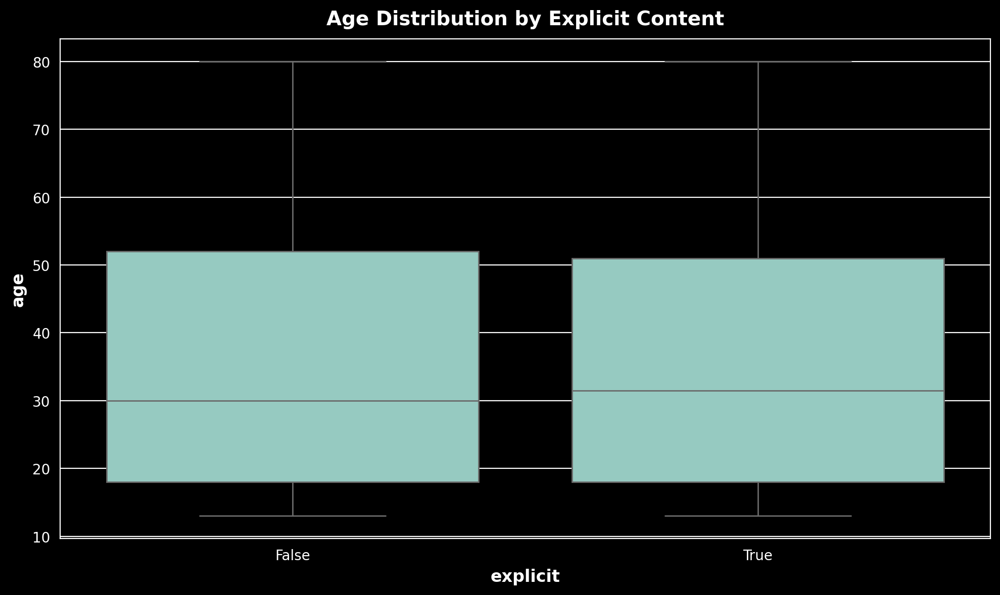

Chi-square statistic: 4.774535222086405
p-value: 0.311


In [60]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='explicit', y='age', data=df)
plt.title('Age Distribution by Explicit Content')
plt.show()

# Chi-square test
contingency_table = pd.crosstab(pd.cut(df['age'], bins=5), df['explicit'])
chi2, p_value, dof, expected = stats.chi2_contingency(contingency_table)
print(f"Chi-square statistic: {chi2}\np-value: {p_value:.3f}")

## Genre and audio features

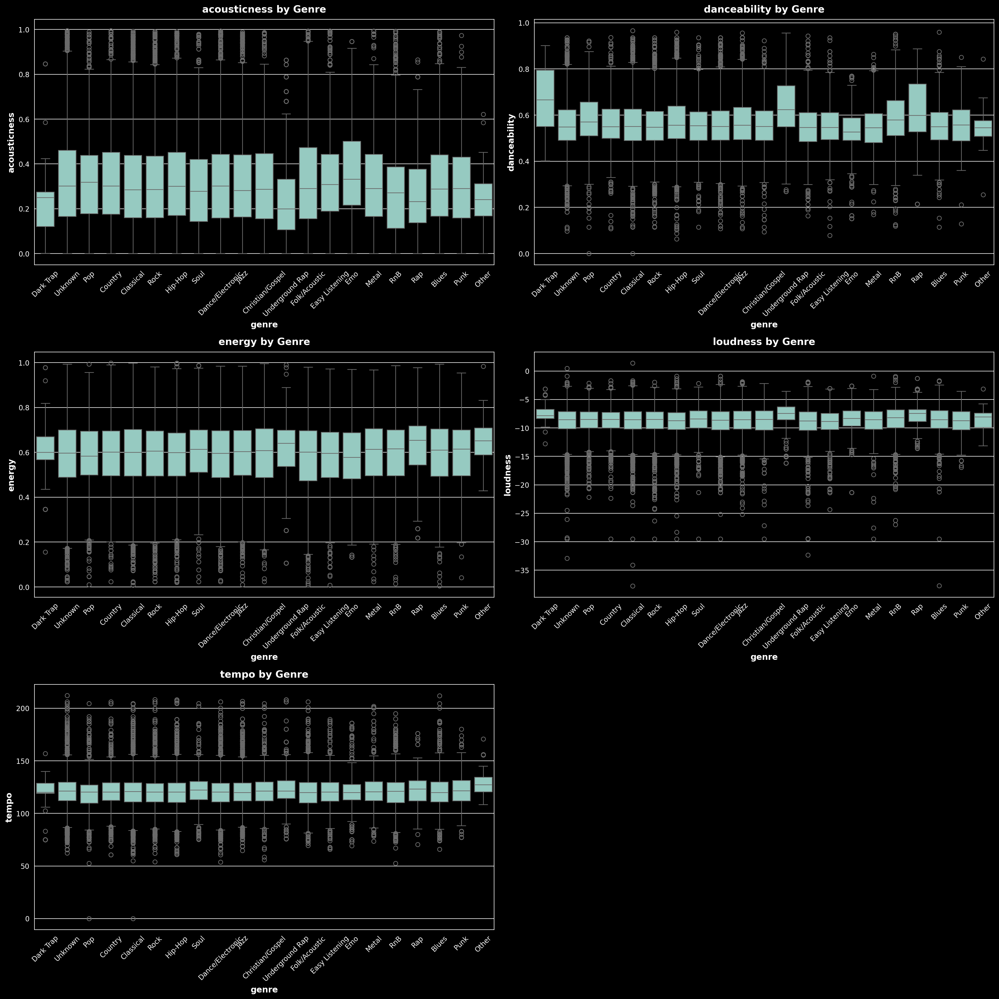

In [62]:
plt.figure(figsize=(20, 20))
for i, feature in enumerate(audio_features, 1):
    plt.subplot(3, 2, i)
    sns.boxplot(x='genre', y=feature, data=df)
    plt.title(f'{feature} by Genre')
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Age and Release Date

## Fix inconsistencies with Date column

In [64]:
df['release_date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 19974 entries, 0 to 19973
Series name: release_date
Non-Null Count  Dtype 
--------------  ----- 
19974 non-null  object
dtypes: object(1)
memory usage: 156.2+ KB


In [65]:
df['release_date'] = pd.to_datetime(df['release_date'],errors='coerce',format="%Y-%m-%d")

In [66]:
df['release_date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 19974 entries, 0 to 19973
Series name: release_date
Non-Null Count  Dtype         
--------------  -----         
14646 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 156.2 KB


In [76]:
df['release_date'].isnull().sum()


5328

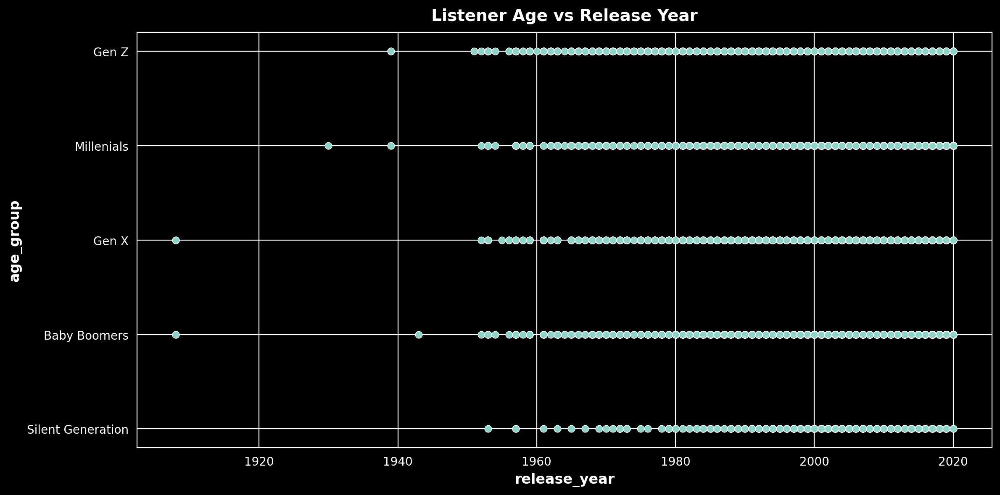

Correlation between age and release year: 0.010


In [68]:
df['release_year'] = df['release_date'].dt.year
plt.figure(figsize=(12, 6))
sns.scatterplot(x='release_year', y='age_group', data=df)
plt.title('Listener Age vs Release Year')
plt.show()

correlation = df['age'].corr(df['release_year'])
print(f"Correlation between age and release year: {correlation:.3f}")

## Gender and artist preferences

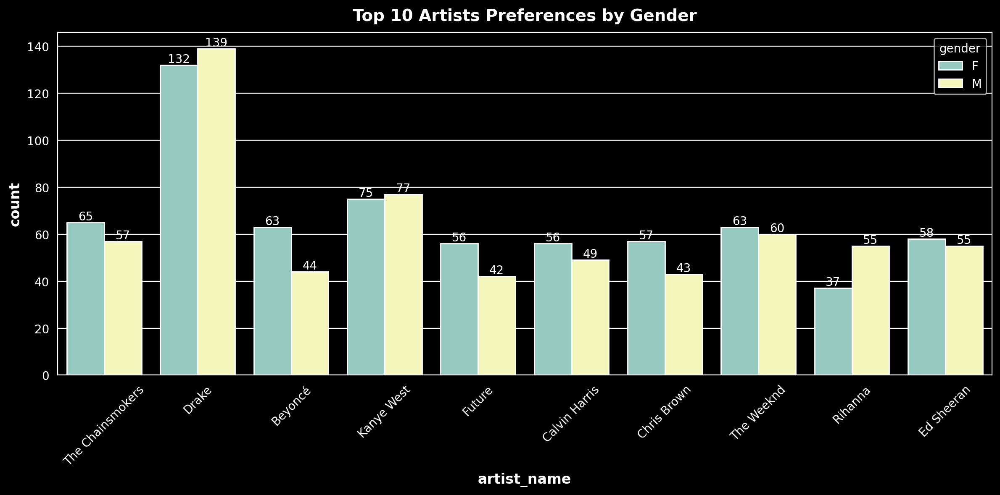

In [69]:
top_artists = df['artist_name'].value_counts().head(10).index
artist_gender_data = df[df['artist_name'].isin(top_artists)]

fig, ax = plt.subplots(figsize=(12, 6))
sns.countplot(x='artist_name', hue='gender', data=artist_gender_data)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
plt.title('Top 10 Artists Preferences by Gender')
plt.xticks(rotation=45)
plt.show()

## Age and tempo preferences

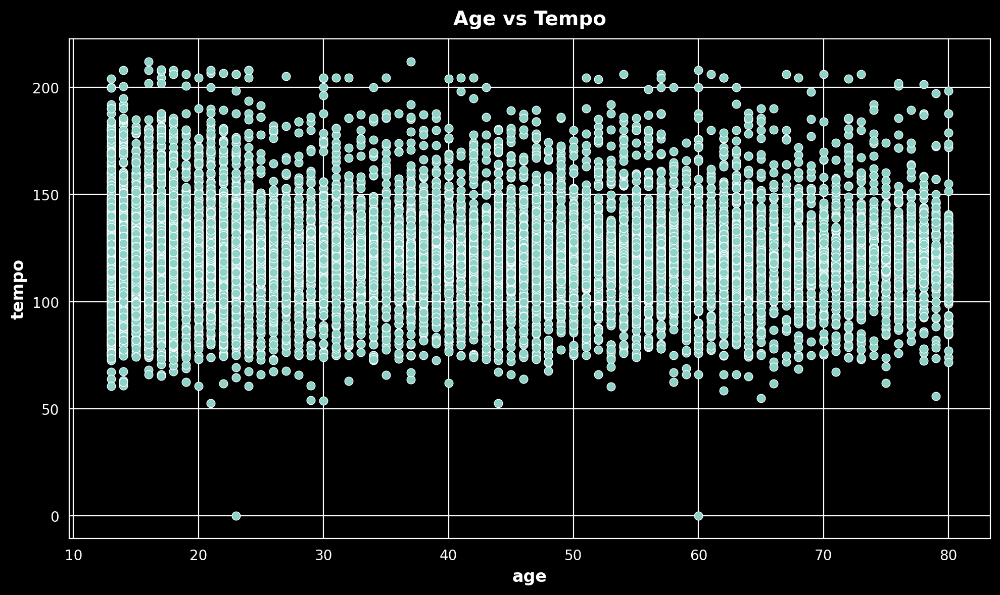

Correlation between age and tempo: 0.004


In [70]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='age', y='tempo', data=df)
plt.title('Age vs Tempo')
plt.show()

correlation = df['age'].corr(df['tempo'])
print(f"Correlation between age and tempo: {correlation:.3f}")

## Gender and Danceability

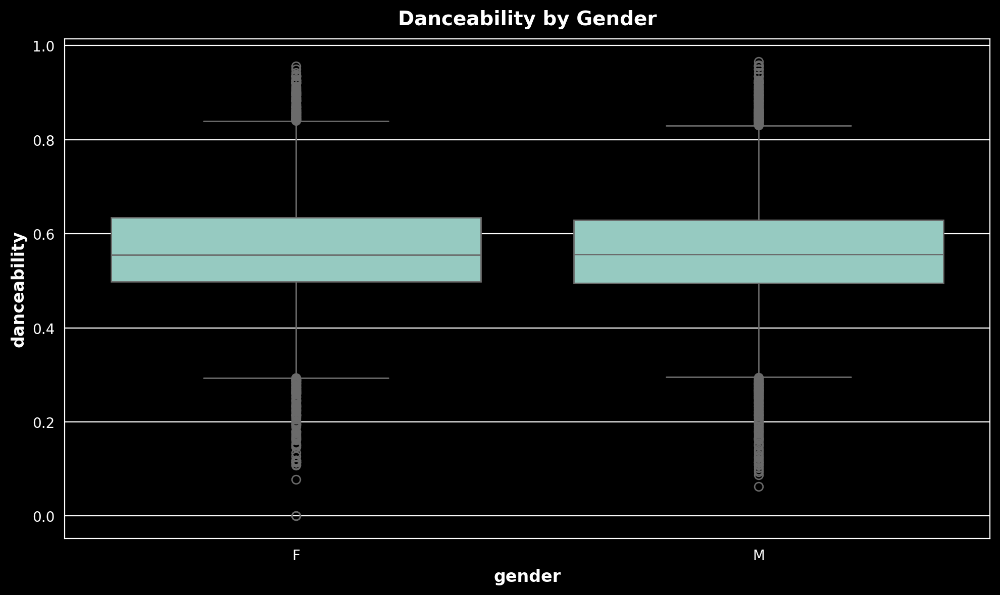

Danceability t-test:
t-statistic = -1.4190306678236608
p-value = 0.15590568087433074


In [71]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='gender', y='danceability', data=df)
plt.title('Danceability by Gender')
plt.show()

t_stat, p_value = stats.ttest_ind(df[df['gender'] == 'M']['danceability'], 
                                  df[df['gender'] == 'F']['danceability'])
print(f"Danceability t-test:\nt-statistic = {t_stat}\np-value = {p_value}")

# Machine Learning Prediction of User Preferences

In [72]:
df.columns

Index(['user_id', 'age', 'gender', 'music', 'artist_name', 'featured_artists',
       'genre', 'duration', 'music_id', 'id_artists', 'acousticness',
       'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature',
       'release_date', 'explicit', 'age_group', 'release_year'],
      dtype='object')

In [73]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

# Prepare df for modeling
features = ['age', 'gender', 'danceability', 'energy']
X = pd.get_dummies(df[features], drop_first=True)
y = df['genre']

# Split df into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a RandomForest Classifier
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict on test set
y_pred = model.predict(X_test)

# Evaluate the model
print('Accuracy:', accuracy_score(y_test, y_pred))
print('Classification Report:')
print(classification_report(y_test, y_pred))


Accuracy: 0.15544430538172715
Classification Report:
                  precision    recall  f1-score   support

           Blues       0.08      0.08      0.08        96
Christian/Gospel       0.19      0.26      0.22        96
       Classical       0.16      0.20      0.18       471
         Country       0.02      0.02      0.02       155
Dance/Electronic       0.13      0.12      0.13       392
       Dark Trap       0.52      0.42      0.46        31
  Easy Listening       0.11      0.09      0.10        91
             Emo       0.28      0.18      0.22       148
   Folk/Acoustic       0.14      0.10      0.12       185
         Hip-Hop       0.18      0.19      0.18       431
            Jazz       0.11      0.11      0.11       292
           Metal       0.06      0.05      0.06        56
           Other       0.20      0.33      0.25         3
             Pop       0.15      0.17      0.16       168
            Punk       0.09      0.07      0.08        30
             Rap  

# Tensorflow recommenders

In [74]:
import tensorflow as tf
import tensorflow_recommenders as tfrs
# import tensorflow_recommenders_addons as tfra
TF_ENABLE_ONEDNN_OPTS=0

2024-07-16 23:36:17.817855: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-07-16 23:36:18.130111: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-16 23:36:18.130203: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-16 23:36:18.186554: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-16 23:36:18.314129: I tensorflow/core/platform/cpu_feature_guar

In [102]:
# Split the data
data = df.copy()

In [103]:
data = data.drop(columns=['release_date','release_year'])

In [104]:
# Ensure all columns have consistent data types
data['user_id'] = data['user_id'].astype(str)
data['music_id'] = data['music_id'].astype(str)
data['age'] = data['age'].astype(int)
data['duration'] = data['duration'].astype(float)
data['acousticness'] = data['acousticness'].astype(float)
data['danceability'] = data['danceability'].astype(float)
data['energy'] = data['energy'].astype(float)
data['key'] = data['key'].astype(int)
data['loudness'] = data['loudness'].astype(float)
data['mode'] = data['mode'].astype(int)
data['speechiness'] = data['speechiness'].astype(float)
data['instrumentalness'] = data['instrumentalness'].astype(float)
data['liveness'] = data['liveness'].astype(float)
data['valence'] = data['valence'].astype(float)
data['tempo'] = data['tempo'].astype(float)
data['time_signature'] = data['time_signature'].astype(float)
data['explicit'] = data['explicit'].astype(bool)

In [105]:
# Split data into training and validation sets
train_data = data.sample(frac=0.8, random_state=42)
val_data = data.drop(train_data.index)

In [106]:
data['music_id'].value_counts()

music_id
7BKLCZ1jbUBVqRi2FVlTVw    33
3a1lNhkSLSkpJE4MSHpDu9    31
7yq4Qj7cqayVTp3FF9CWbm    31
152lZdxL1OR0ZMW6KquMif    27
1xznGGDReH1oQq0xzbwXa3    22
                          ..
0YlUnqnC63U8hRGOkDDHie     1
2q1OWwNmVEg9pb0nnzrFVP     1
139AsM1OAu63s4zbZ00tFq     1
2we1ouAzi78tmtDJ72dX85     1
1LfSbPH1QCPxce41b9mmYF     1
Name: count, Length: 11528, dtype: int64

## Collaborative Filtering

In [107]:
import tensorflow as tf
print(tf.__version__)

2.15.1


In [108]:
# Convert DataFrame to dictionary
train_dict = {col: train_data[col].values for col in train_data.columns}
val_dict = {col: val_data[col].values for col in val_data.columns}


In [115]:
import tensorflow_datasets as tfds

# Prepare TensorFlow Datasets
train = tf.data.Dataset.from_tensor_slices(train_dict).map(
    lambda x: {
        'user_id': user_model(x['user_id']),
        'age': x['age'],
        # 'education': x['education'],
        'gender': x['gender'],
        # 'country': x['country'],
        'music': x['music'],
        'music_id': item_model(x['music_id']),
        'acousticness': x['acousticness'],
        'danceability': x['danceability'],
        'energy': x['energy'],
        'key': x['key'],
        'loudness': x['loudness'],
        'mode': x['mode'],
        'speechiness': x['speechiness'],
        'instrumentalness': x['instrumentalness'],
        'liveness': x['liveness'],
        'valence': x['valence'],
        'tempo': x['tempo'],
        'time_signature': x['time_signature'],
        'explicit': x['explicit']
    }
)

val = tf.data.Dataset.from_tensor_slices(val_dict).map(
    lambda x: {
        'user_id': user_model(x['user_id']),
        'age': x['age'],
        # 'education': x['education'],
        'gender': x['gender'],
        # 'country': x['country'],
        'music': x['music'],
        'music_id': item_model(x['music_id']),
        'acousticness': x['acousticness'],
        'danceability': x['danceability'],
        'energy': x['energy'],
        'key': x['key'],
        'loudness': x['loudness'],
        'mode': x['mode'],
        'speechiness': x['speechiness'],
        'instrumentalness': x['instrumentalness'],
        'liveness': x['liveness'],
        'valence': x['valence'],
        'tempo': x['tempo'],
        'time_signature': x['time_signature'],
        'explicit': x['explicit']
    }
)

# Batch the datasets
train = train.batch(128)
val = val.batch(128)

# Prefetch the datasets
train = train.prefetch(tf.data.AUTOTUNE)
val = val.prefetch(tf.data.AUTOTUNE)


In [133]:
# Define user and item features
user_model = tf.keras.Sequential([
    tf.keras.layers.StringLookup(vocabulary=train_data['user_id'].unique(), mask_token=None),
    tf.keras.layers.Embedding(len(train_data['user_id'].unique()) + 1, 32)
])

item_model = tf.keras.Sequential([
    tf.keras.layers.StringLookup(vocabulary=train_data['music_id'].unique(), mask_token=None),
    tf.keras.layers.Embedding(len(train_data['music_id'].unique()) + 1, 32)
])

# Define additional content-based features
audio_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence']
audio_inputs = {feature: tf.keras.Input(shape=(1,), dtype=tf.float32, name=feature) for feature in audio_features}

# Wrap user_model and item_model inside tf.keras.Input layers
user_inputs = tf.keras.Input(shape=(1,), dtype=tf.string, name='user_id')
item_inputs = tf.keras.Input(shape=(1,), dtype=tf.string, name='item_id')

# Embed user and item inputs
user_embedded = user_model(user_inputs['user_id'])
item_embedded = item_model(item_inputs['music_id'])

# Embed audio features
audio_embedded = tf.keras.layers.Concatenate()([audio_inputs[feature] for feature in audio_features])

# Combine all features
combined_features = tf.keras.layers.Concatenate()([user_embedded, item_embedded, audio_embedded])
output = tf.keras.layers.Dense(1)(combined_features)

# Define the retrieval task
task = tfrs.tasks.Ranking()

# Create the final model
hybrid_model = tf.keras.Model(
    inputs={**user_inputs, **item_inputs, **audio_inputs},
    outputs=output
)

hybrid_model.compile(
    optimizer='adam',
    loss=tf.keras.losses.MeanSquaredError(),
    metrics=[tf.keras.metrics.RootMeanSquaredError()]
)

TypeError: Exception encountered when calling layer "tf.__operators__.getitem_2" (type SlicingOpLambda).

Only integers, slices (`:`), ellipsis (`...`), tf.newaxis (`None`) and scalar tf.int32/tf.int64 tensors are valid indices, got 'user_id'

Call arguments received by layer "tf.__operators__.getitem_2" (type SlicingOpLambda):
  • tensor=tf.Tensor(shape=(None, 1), dtype=string)
  • slice_spec='user_id'
  • var=None

## Content Based Filtering